In [1]:
import pandas as pd
import numpy as np
import torch 
%matplotlib inline
import math
import scipy.stats
import time
from sklearn.metrics import mean_squared_error,mean_absolute_error
import torch.utils.data as Data
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import SGD
import matplotlib.pyplot as plt

In [2]:
class Timer:  #@save
    """记录多次运行时间"""
    def __init__(self):
        self.times = []
        self.start()
    def start(self):
        """启动计时器"""
        self.tik = time.time()
    def stop(self):
        """停止计时器并将时间记录在列表中"""
        self.times.append(time.time() - self.tik)
        return self.times[-1]
    def avg(self):
        """返回平均时间"""
        return sum(self.times) / len(self.times)
    def sum(self):
        """返回时间总和"""
        return sum(self.times)
    def cumsum(self):
        """返回累计时间"""
        return np.array(self.times).cumsum().tolist()

In [3]:
train=pd.read_feather('J:quant_trade/trains.feather')
test=pd.read_feather('J:/quant_trade/tests.feather')


In [5]:
tlist=train.columns.tolist()
tlist=tlist[3:103]
print(tlist)

['1d', '2d', '3d', '4d', '5d', '6d', '7d', '8d', '9d', '10d', '11d', '12d', '13d', '14d', '15d', '16d', '17d', '18d', '19d', '20d', '21d', '22d', '23d', '24d', '25d', '26d', '27d', '28d', '29d', '30d', '31d', '32d', '33d', '34d', '35d', '36d', '37d', '38d', '39d', '40d', '41d', '42d', '43d', '44d', '45d', '46d', '47d', '48d', '49d', '50d', '51d', '52d', '53d', '54d', '55d', '56d', '57d', '58d', '59d', '60d', '61d', '62d', '63d', '64d', '65d', '66d', '67d', '68d', '69d', '70d', '71d', '72d', '73d', '74d', '75d', '76d', '77d', '78d', '79d', '80d', '81d', '82d', '83d', '84d', '85d', '86d', '87d', '88d', '89d', '90d', '91d', '92d', '93d', '94d', '95d', '96d', '97d', '98d', '99d', '100d']


In [6]:
x_train=train[tlist]
y_train=train['1W']
x_test=test[tlist]
y_test=test['1W']

In [7]:
train_xt=torch.from_numpy(x_train.values.astype(np.float32)).cuda()
train_yt=torch.from_numpy(y_train.values.astype(np.float32)).cuda()
test_xt=torch.from_numpy(x_test.values.astype(np.float32)).cuda()
test_yt=torch.from_numpy(y_test.values.astype(np.float32)).cpu()

In [8]:
train=None
test=None
x_train=None
y_train=None
x_test=None
y_test=None

In [9]:
import gc
gc.collect()

14

In [10]:
train_data=Data.TensorDataset(train_xt,train_yt)
test_data=Data.TensorDataset(test_xt,test_yt)

In [11]:
class MLPrg(nn.Module):
    def __init__(self):
        super(MLPrg,self).__init__()
        self.hidden1=nn.Linear(in_features=100,out_features=512,bias=True)
        self.drop=nn.Dropout(0.2)
        self.hidden2=nn.Linear(in_features=512,out_features=256)
        self.predict=nn.Linear(256,1)
    def forward(self,x):
        x=F.tanh(self.hidden1(x))
        x=self.drop(x)
        x=F.tanh(self.hidden2(x))
        x=self.drop(x)
        output=self.predict(x)
        return output[:,0]
rg=MLPrg()
rg=rg.cuda()
loss_func=nn.MSELoss()
loss_func=loss_func.cuda()
train_loss_all=[]
maslist=[]
plt.figure(figsize=(10,6))

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

In [12]:
train_loader=Data.DataLoader(dataset=train_data,batch_size=256,shuffle=True,num_workers=0)
for step,(b_x,b_y) in enumerate(train_loader):
    if step>0:
        break

In [13]:
optimizer=torch.optim.Adam(rg.parameters(),lr=0.1)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

In [14]:
info=[]

In [ ]:
rg=MLPrg().cuda()
optimizer=torch.optim.Adam(rg.parameters(),lr=0.1)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
for epoch in range(1):
    timer = Timer()
    train_loss=0
    train_num=0
    for step,(b_x,b_y) in enumerate(train_loader):
        b_x=b_x.cuda()
        b_y=b_y.cuda()
        output=rg(b_x)
        loss=loss_func(output,b_y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        train_loss+=loss.item()*b_x.size(0)
        train_num+=b_x.size(0)
    scheduler.step()
    train_loss_all.append(train_loss/train_num)
    testy=rg(test_xt)
    testy=testy.cpu()
    mae=mean_absolute_error(test_yt.detach().numpy(),testy.detach().numpy())
    df=pd.DataFrame()
    df['real']=test_yt
    df['pre']=testy.detach().numpy()
    idx=scipy.stats.ks_2samp(df['pre'],df['real'])
    ks=scipy.stats.ks_2samp(df['pre'],df['real'])[0]
    minks=min(minks,ks)
    if minks==ks:
        torch.save(rg,'J:/quant_trade/modelbase/bestks.pt')
    plt.scatter(y=df['real'],x=range(df.shape[0]),color='red')
    plt.scatter(y=df['pre'],x=range(df.shape[0]),color='blue')
    plt.show()
    plt.close()
    plt.hist(df['real'],color='red')
    plt.hist(df['pre'],color='blue')
    plt.show()
    plt.close()
    info.append([str(epoch),train_loss/train_num,mae,timer.stop(),ks,idx])
    pd.DataFrame(info).to_html('data.html')

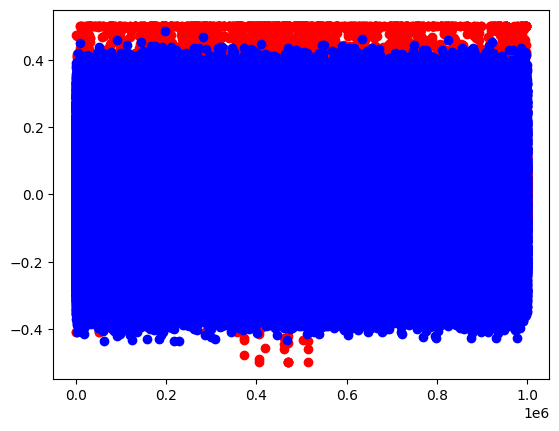

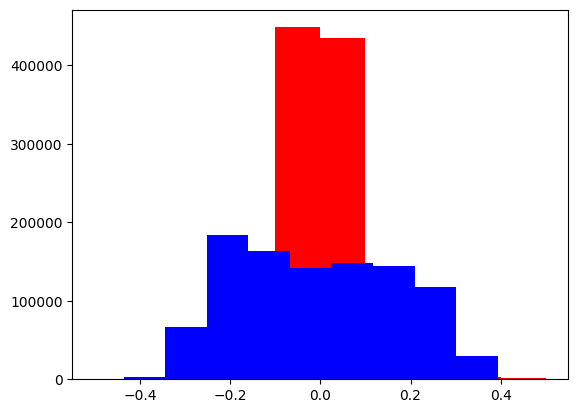

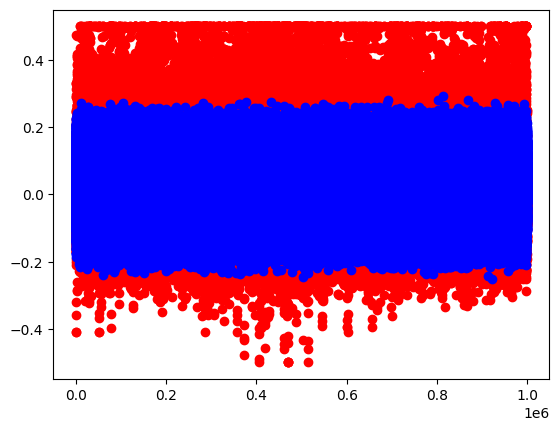

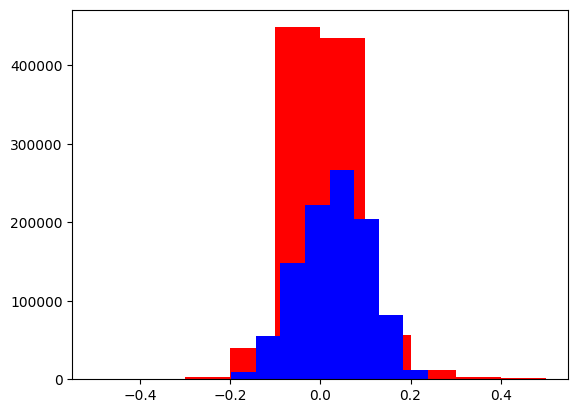

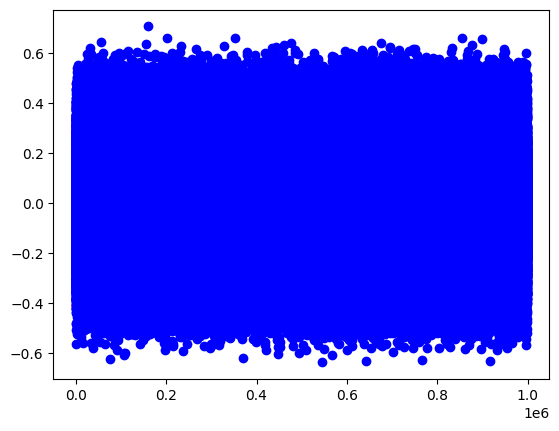

...

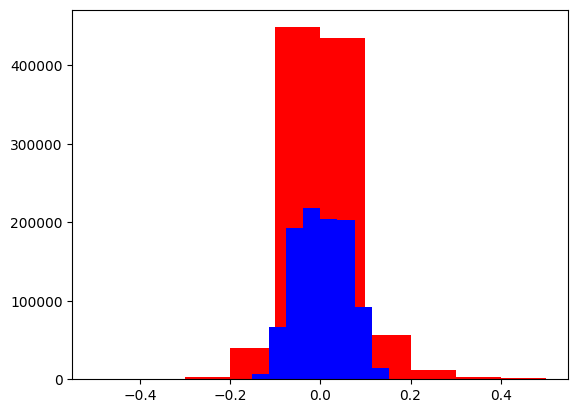

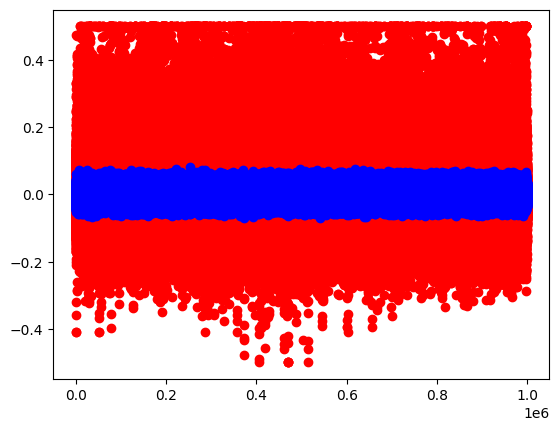

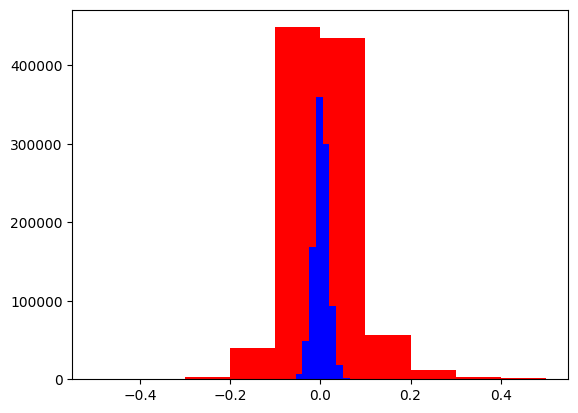

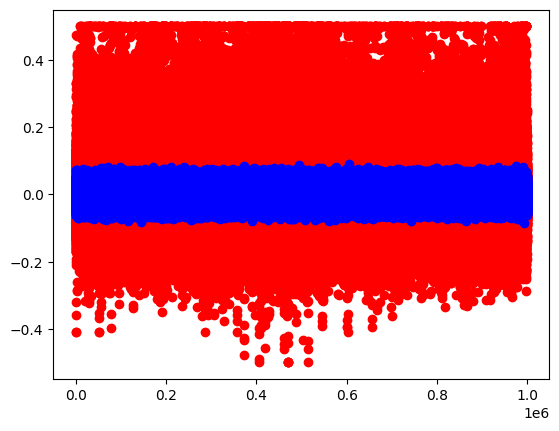

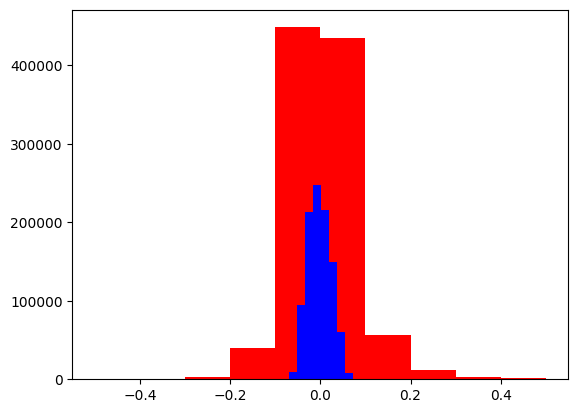

KeyboardInterrupt: 

In [12]:
minks=9999
while True:
    rg=MLPrg().cuda()
    optimizer=torch.optim.Adam(rg.parameters(),lr=0.1)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
    for epoch in range(8):
        timer = Timer()
        
        train_loss=0
        train_num=0
        for step,(b_x,b_y) in enumerate(train_loader):
            b_x=b_x.cuda()
            b_y=b_y.cuda()
            output=rg(b_x)
            loss=loss_func(output,b_y)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            train_loss+=loss.item()*b_x.size(0)
            train_num+=b_x.size(0)
        scheduler.step()
        train_loss_all.append(train_loss/train_num)
        testy=rg(test_xt)
        testy=testy.cpu()
        mae=mean_absolute_error(test_yt.detach().numpy(),testy.detach().numpy())
        df=pd.DataFrame()
        df['real']=test_yt
        df['pre']=testy.detach().numpy()
        idx=scipy.stats.ks_2samp(df['pre'],df['real'])
        ks=scipy.stats.ks_2samp(df['pre'],df['real'])[0]
        minks=min(minks,ks)
        if minks==ks:
            torch.save(rg,'J:/quant_trade/modelbase/bestks.pt')
        plt.scatter(y=df['real'],x=range(df.shape[0]),color='red')
        plt.scatter(y=df['pre'],x=range(df.shape[0]),color='blue')
        plt.show()
        plt.close()
        plt.hist(df['real'],color='red')
        plt.hist(df['pre'],color='blue')
        plt.show()
        plt.close()
        info.append([str(epoch),train_loss/train_num,mae,timer.stop(),ks,idx])
        pd.DataFrame(info).to_html('data.html')